# A Notebook for Visualizing Attention Maps

In [1]:
# import typing
# import io
import os

import torch
import numpy as np
import cv2
import matplotlib.pyplot as plt

# from urllib.request import urlretrieve

from PIL import Image
import cv2
import torchvision

from transformers import ViTModel
from transformers import ViTFeatureExtractor, AutoImageProcessor
import sys
import torchvision.transforms as transforms

# from models.modeling import VisionTransformer, CONFIGS

/home/lmeyers/anaconda3/envs/mlenv/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
2024-11-14 14:56:26.685698: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-11-14 14:56:27.634046: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


### Load Image

(1803, 1809, 3)


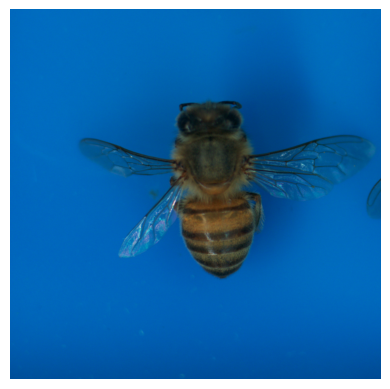

In [2]:
test_image_path = "/home/lmeyers/arducam20MP_close_single-bee.jpg" #DSC_4539.png" #"/home/lmeyers/summer_bee_data_reextract/images/young-adults-white-blue-outside-97-128_batch_2_pass_2.mp4.track000247.frame044738.png" ## "/home/lmeyers/mango_images/train/video__tommy_atkins_week1_day1_20180126_09h18__frame68730_1.png"# "/home/lmeyers/SLEAP_files/Bee_imgs/old/filesort/unhelpful/no_paint/f2x2022_06_20.mp4.track000003.frame001871.jpg" #"/home/lmeyers/DSC_4539.png" # "/home/lmeyers/SinlgeBeeTest.png"  #
test_image = cv2.imread(test_image_path)
test_image = cv2.cvtColor(test_image, cv2.COLOR_RGB2BGR)
test_image_np = np.array(test_image)
print(test_image.shape)
plt.imshow(test_image)
plt.axis("off")
plt.show()

## Load Models

In [3]:
  
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"using device: {device}")


using device: cuda


Pretrained VIT 

In [5]:
# Test Image
sys.path.insert(0,"../")

# print('Getting ViT feature extractor...')
model_name = 'google/vit-base-patch16-224-in21k'
#model_path = "/home/lmeyers/contrastive_learning_new_training/64_ids_batch1_sample_num_64/64_ids_batch1_sample_num_64.pth"

feature_extractor = AutoImageProcessor.from_pretrained(model_name)


# model = torch.load(model_path)
# model = model.vit

model = ViTModel.from_pretrained(model_name)
model.config.output_attentions = True
model.to(device)
print(model.config.output_attentions)


True


In [20]:
##inspect vit structure

print(-1*(len(model.encoder.layer)-1))


-11


BIOCIP

In [72]:
import open_clip

bio_model, preprocess_train, preprocess_val = open_clip.create_model_and_transforms('hf-hub:imageomics/bioclip',jit=False)
print(bio_model.visual)
tokenizer = open_clip.get_tokenizer('hf-hub:imageomics/bioclip')
bio_model.to(device)



# torch.save(bio_model,"bioClip_output_att.pth")

VisionTransformer(
  (conv1): Conv2d(3, 768, kernel_size=(16, 16), stride=(16, 16), bias=False)
  (patch_dropout): Identity()
  (ln_pre): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
  (transformer): Transformer(
    (resblocks): ModuleList(
      (0-11): 12 x ResidualAttentionBlock(
        (ln_1): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
        (attn): MultiheadAttention(
          (out_proj): NonDynamicallyQuantizableLinear(in_features=768, out_features=768, bias=True)
        )
        (ls_1): Identity()
        (ln_2): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
        (mlp): Sequential(
          (c_fc): Linear(in_features=768, out_features=3072, bias=True)
          (gelu): GELU(approximate='none')
          (c_proj): Linear(in_features=3072, out_features=768, bias=True)
        )
        (ls_2): Identity()
      )
    )
  )
  (ln_post): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
)


CLIP(
  (visual): VisionTransformer(
    (conv1): Conv2d(3, 768, kernel_size=(16, 16), stride=(16, 16), bias=False)
    (patch_dropout): Identity()
    (ln_pre): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
    (transformer): Transformer(
      (resblocks): ModuleList(
        (0-11): 12 x ResidualAttentionBlock(
          (ln_1): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
          (attn): MultiheadAttention(
            (out_proj): NonDynamicallyQuantizableLinear(in_features=768, out_features=768, bias=True)
          )
          (ls_1): Identity()
          (ln_2): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
          (mlp): Sequential(
            (c_fc): Linear(in_features=768, out_features=3072, bias=True)
            (gelu): GELU(approximate='none')
            (c_proj): Linear(in_features=3072, out_features=768, bias=True)
          )
          (ls_2): Identity()
        )
      )
    )
    (ln_post): LayerNorm((768,), eps=1e-05, elementwise_affine

#### Load Feature Extractors and Perform Image Transforms

In [73]:
from transformers import CLIPFeatureExtractor


clip_flattener = CLIPFeatureExtractor()
#test_image = transforms.functional.to_pil_image(test_image) 
x_c = feature_extractor(test_image)['pixel_values']# #clip_flattener(test_image)['pixel_values'] 
x_ct = torch.tensor(x_c, dtype=torch.float)
x_ct = x_ct.to(device)




/home/lmeyers/anaconda3/envs/mlenv/lib/python3.9/site-packages/transformers/models/clip/feature_extraction_clip.py:28: FutureWarning: The class CLIPFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use CLIPImageProcessor instead.
  warnings.warn(


In [74]:
print(feature_extractor)
print(x_ct.max())
print(test_image_np.max())    

ViTImageProcessor {
  "do_normalize": true,
  "do_rescale": true,
  "do_resize": true,
  "image_mean": [
    0.5,
    0.5,
    0.5
  ],
  "image_processor_type": "ViTImageProcessor",
  "image_std": [
    0.5,
    0.5,
    0.5
  ],
  "resample": 2,
  "rescale_factor": 0.00392156862745098,
  "size": {
    "height": 224,
    "width": 224
  }
}

tensor(0.6000, device='cuda:0')
255


torch.cuda.FloatTensor


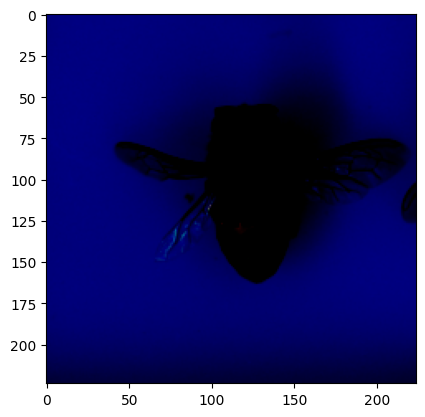

In [75]:
#print(test_image_tens.size())
#x = test_image_tens
#print(x.size())
x = x_ct

print(x.type())
x_m = x.squeeze(0)
x_mcl = torch.moveaxis(x_m,0,-1)

x_np = x_mcl.detach().cpu().numpy()

plt.imshow(x_np)
plt.show()


#### Display patch Visualization

In [76]:
# x_ca = np.moveaxis(x_c[0],0,-1)
# first_patch = x_ca[0:16,0:16,:]
# print(first_patch.shape)
# flat_patch = first_patch.flatten()
# print(flat_patch.shape)
# display_ind_barcode(flat_patch,cmap="jet")
# from torch import conv1d
# flat_conv = conv1d(torch.tensor(flat_patch))
# print(flat_conv.size())

### Predict on Image and get outputs

In [77]:
bio_output = bio_model(x)
vis_out = bio_output[0]

logits = vis_out[0]
print(logits.size())
att_mat = vis_out[1]
att_mat = torch.stack(att_mat)
att_mat = torch.moveaxis(att_mat,1,-1)
print(att_mat.size())
att_mat = torch.squeeze(att_mat)
print(att_mat.size())
# output_pred = torch.nn.Softmax(output)
# print(output_pred)
# print(torch.argmax(output[0]))



torch.Size([1, 512])
torch.Size([12, 12, 197, 197, 1])
torch.Size([12, 12, 197, 197])


In [78]:
# print(bio_model.visual.conv1)
# conv_out = torch.moveaxis(bio_model.visual.conv1(x_ct.to(device)).squeeze(0),0,-1)
# print(conv_out.size())
# from vis_utils import display_ind_barcode
# display_ind_barcode(conv_out[0][0].detach().cpu().numpy(),cmap="jet")

In [79]:
layer_idx = 0
print(f"Showing heads from layer {layer_idx}")
for i, head in enumerate(att_mat[layer_idx]):
    print(f"showing head {i}")
    print(head[i])
    print(head[i].size())
    

Showing heads from layer 0
showing head 0
tensor([0.3280, 0.0017, 0.0017, 0.0016, 0.0017, 0.0017, 0.0018, 0.0017, 0.0017,
        0.0017, 0.0016, 0.0016, 0.0015, 0.0016, 0.0018, 0.0022, 0.0022, 0.0021,
        0.0022, 0.0023, 0.0025, 0.0024, 0.0023, 0.0024, 0.0022, 0.0021, 0.0020,
        0.0019, 0.0023, 0.0024, 0.0024, 0.0022, 0.0024, 0.0026, 0.0029, 0.0028,
        0.0026, 0.0027, 0.0025, 0.0025, 0.0022, 0.0021, 0.0024, 0.0024, 0.0025,
        0.0024, 0.0026, 0.0030, 0.0033, 0.0066, 0.0065, 0.0064, 0.0028, 0.0028,
        0.0024, 0.0023, 0.0025, 0.0026, 0.0027, 0.0029, 0.0033, 0.0035, 0.0041,
        0.0071, 0.0069, 0.0059, 0.0035, 0.0031, 0.0032, 0.0037, 0.0029, 0.0028,
        0.0029, 0.0031, 0.0045, 0.0071, 0.0078, 0.0096, 0.0097, 0.0084, 0.0086,
        0.0082, 0.0043, 0.0038, 0.0034, 0.0028, 0.0031, 0.0029, 0.0034, 0.0045,
        0.0059, 0.0101, 0.0099, 0.0098, 0.0059, 0.0047, 0.0052, 0.0029, 0.0038,
        0.0029, 0.0030, 0.0030, 0.0031, 0.0036, 0.0061, 0.0113, 0.0099, 0.0084

/tmp/ipykernel_1810187/3856641390.py:36: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cm.get_cmap('jet')


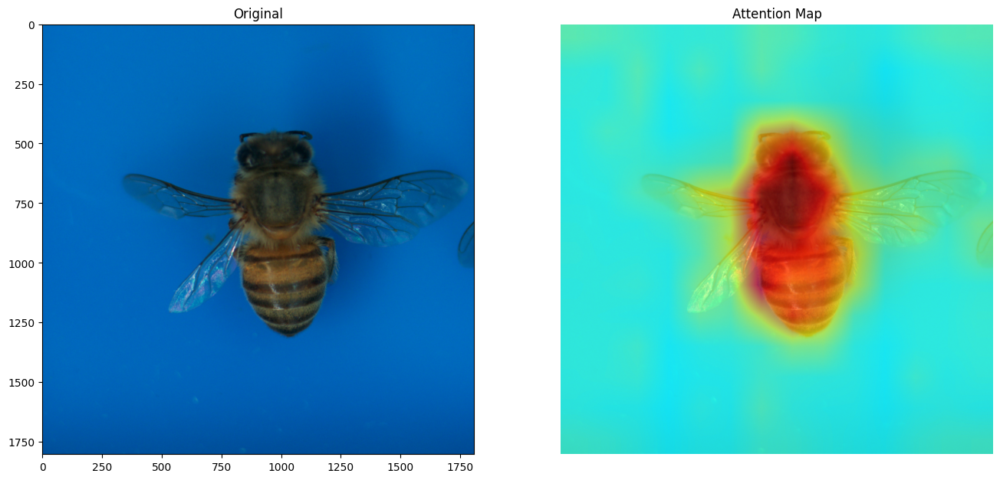

In [82]:
import matplotlib.cm as cm
from vis_utils import display_histogram

## function for displaying att mat:
def display_composite_att(att_mat,image):
    """att matt: tensor (layers, tokens, tokens)
     image: np array of pixel values"""
    
    num_layers = len(att_mat)
    test_image_np = image

    # To account for residual connections, we add an identity matrix to the
    # attention matrix and re-normalize the weights.
    residual_att = torch.eye(att_mat.size(1)).to(device)

    aug_att_mat = att_mat + residual_att
    aug_att_mat = aug_att_mat / aug_att_mat.sum(dim=-1).unsqueeze(-1)
    # print(aug_att_mat.size())

    # Recursively multiply the weight matrices
    joint_attentions = torch.zeros(aug_att_mat.size()).to(device)
    joint_attentions[0] = aug_att_mat[0]
    # print(aug_att_mat.size(),aug_att_mat[0].size())
    # print(joint_attentions.size())

    for n in range(1, aug_att_mat.size(0)):
        joint_attentions[n] = torch.matmul(aug_att_mat[n], joint_attentions[n-1])
        # print(f"multiplying aug_att_mat[{n}] by joint[{n-1}] to set joint[{n}]")
    # Attention from the output token to the input space.
    v = joint_attentions[-1]
    grid_size = int(np.sqrt(aug_att_mat.size(-1)))
    mask = v[0, 1:].reshape(grid_size, grid_size).cpu().detach().numpy()
    mask = cv2.resize(mask / mask.max(), (test_image_np.shape[1], test_image_np.shape[0]))[..., np.newaxis]

    import matplotlib.cm as cm
    cmap = cm.get_cmap('jet')
    # Convert the normalized data to RGBA (0-255)
    rgba_array = (cmap(mask) * 255).astype(np.uint8)
    rgba_array = np.moveaxis(rgba_array,2,-1).squeeze()
    rgb_array = rgba_array[..., :3]

    assert rgb_array.shape == test_image_np.shape
    assert rgb_array.dtype == test_image_np.dtype
    # Now blend the images
    result = cv2.addWeighted(rgb_array, 0.7, test_image_np, 0.5, 0)

    fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(16, 16))
    ax1.set_title('Original')
    ax2.set_title('Attention Map')
    _ = ax1.imshow(test_image_np)
    _ = ax2.imshow(result)
    plt.axis("off")


## function for displaying att mat:
def display_att_layer(att_mat,image):
    """att matt: tensor (tokens, tokens)
     image: np array of pixel values"""
    
   
    test_image_np = image

    #  # Average attention weights across heads (already done)
    # att_mat = torch.mean(att_mat, dim=0)

    # Add residual connection (identity) and normalize
    residual_att = torch.eye(att_mat.size(0)).to(device)
    aug_att_mat = att_mat + residual_att
    aug_att_mat = aug_att_mat / aug_att_mat.sum(dim=-1).unsqueeze(-1)
    
    # Attention from the output token to the input space
    grid_size = int(np.sqrt(aug_att_mat.size(-1)))
    mask = aug_att_mat[0, 1:].reshape(grid_size, grid_size).cpu().detach().numpy()
    
    # Resize mask to match the input image dimensions
    mask = cv2.resize(mask / mask.max(), (test_image_np.shape[1], test_image_np.shape[0]))[..., np.newaxis]
    

    cmap = cm.get_cmap('jet')
    # Convert the normalized data to RGBA (0-255)
    rgba_array = (cmap(mask) * 255).astype(np.uint8)
    rgba_array = np.moveaxis(rgba_array,2,-1).squeeze()
    rgb_array = rgba_array[..., :3]

    assert rgb_array.shape == test_image_np.shape
    assert rgb_array.dtype == test_image_np.dtype
    # Now blend the images
    result = cv2.addWeighted(rgb_array, 0.7, test_image_np, 0.5, 0)

    fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(16, 16))
    ax1.set_title('Original')
    ax2.set_title('Attention Map')
    _ = ax1.imshow(test_image_np)
    _ = ax2.imshow(result)
    plt.axis("off")

display_composite_att(att_mat.mean(dim=1),test_image_np)

Layer wise shape:  torch.Size([12, 38809])
Layer wise max:  torch.return_types.max(
values=tensor([0.7484, 0.0321, 0.0160,  ..., 0.0114, 0.0195, 0.0331], device='cuda:0',
       grad_fn=<MaxBackward0>),
indices=tensor([5, 0, 0,  ..., 9, 0, 0], device='cuda:0'))
Att_all shape: (12, 197, 197)
Att_all max: 0.9999944
Att_class_token shape: (12, 196)
Prenormed min:  3.1668562e-05 Prenormed max:  0.070689216
Normed att max and min:  1.0 0.0
Colormap shape:  (12, 196, 4)


/tmp/ipykernel_1810187/999101592.py:35: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cm.get_cmap('jet')


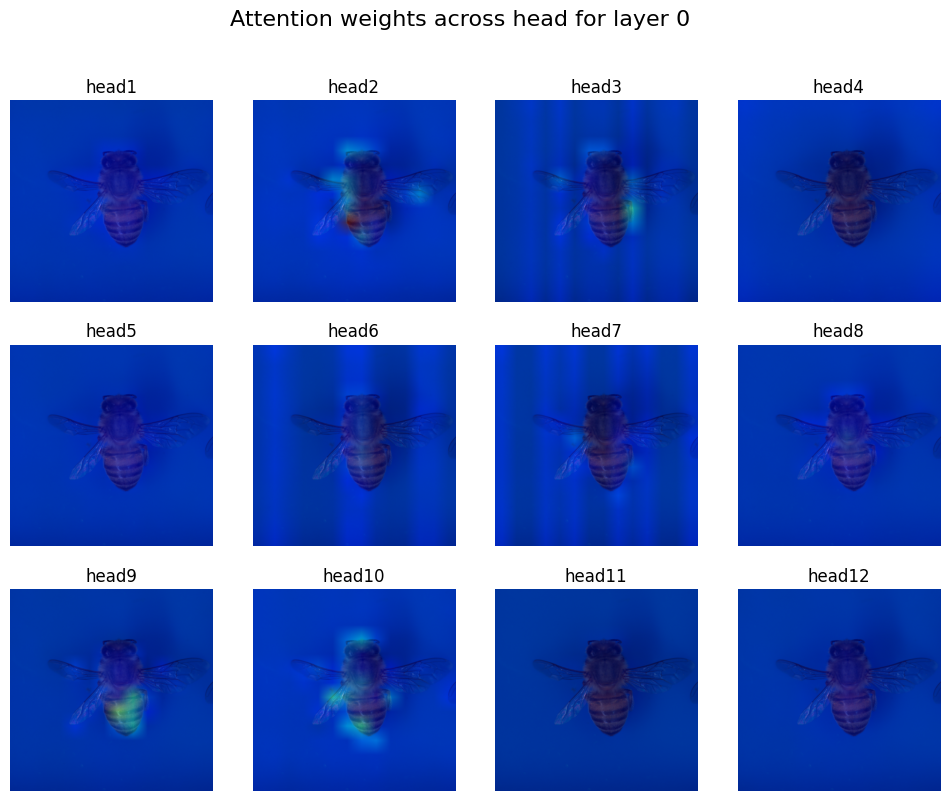

Att_all shape: (12, 197, 197)
Att_all max: 0.9026949
Att_class_token shape: (12, 196)
Prenormed min:  0.00023428016 Prenormed max:  0.019761067
Normed att max and min:  0.9999999 0.0
Colormap shape:  (12, 196, 4)


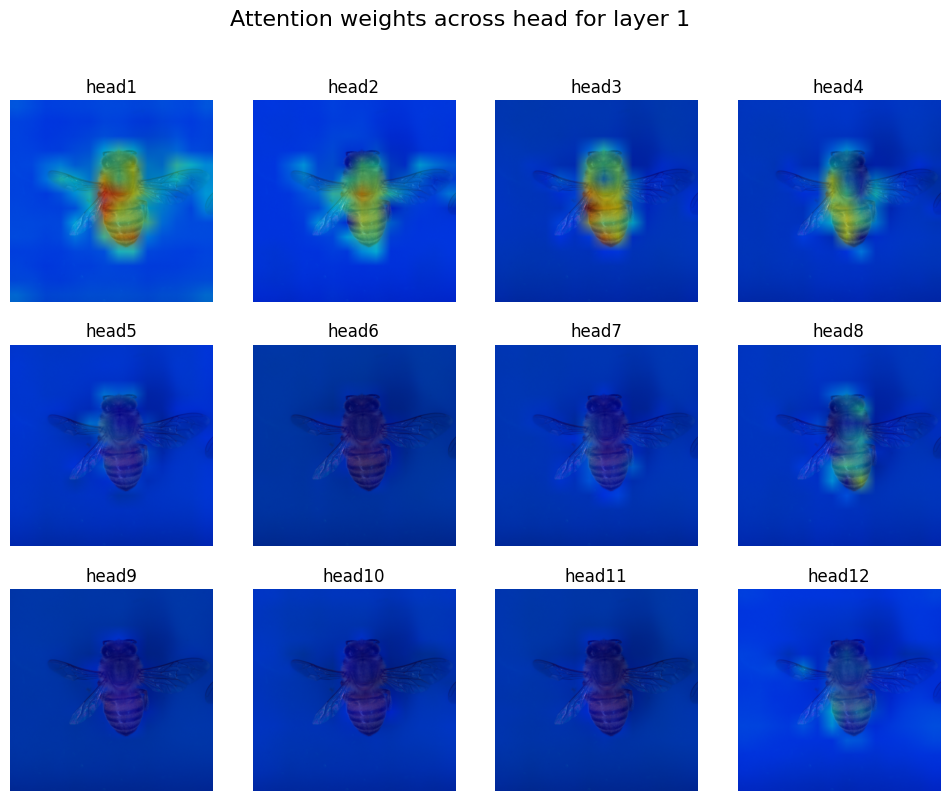

Att_all shape: (12, 197, 197)
Att_all max: 0.9918717
Att_class_token shape: (12, 196)
Prenormed min:  3.171722e-05 Prenormed max:  0.035101123
Normed att max and min:  1.0 0.0
Colormap shape:  (12, 196, 4)


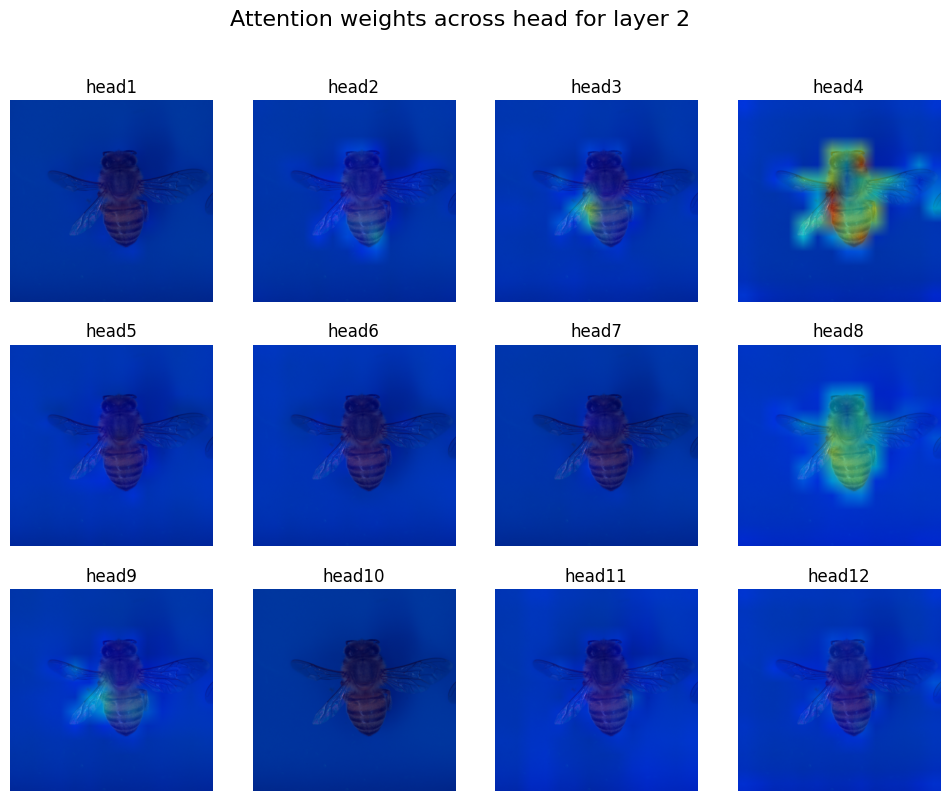

Att_all shape: (12, 197, 197)
Att_all max: 0.98915905
Att_class_token shape: (12, 196)
Prenormed min:  0.00013693984 Prenormed max:  0.036853112
Normed att max and min:  1.0 0.0
Colormap shape:  (12, 196, 4)


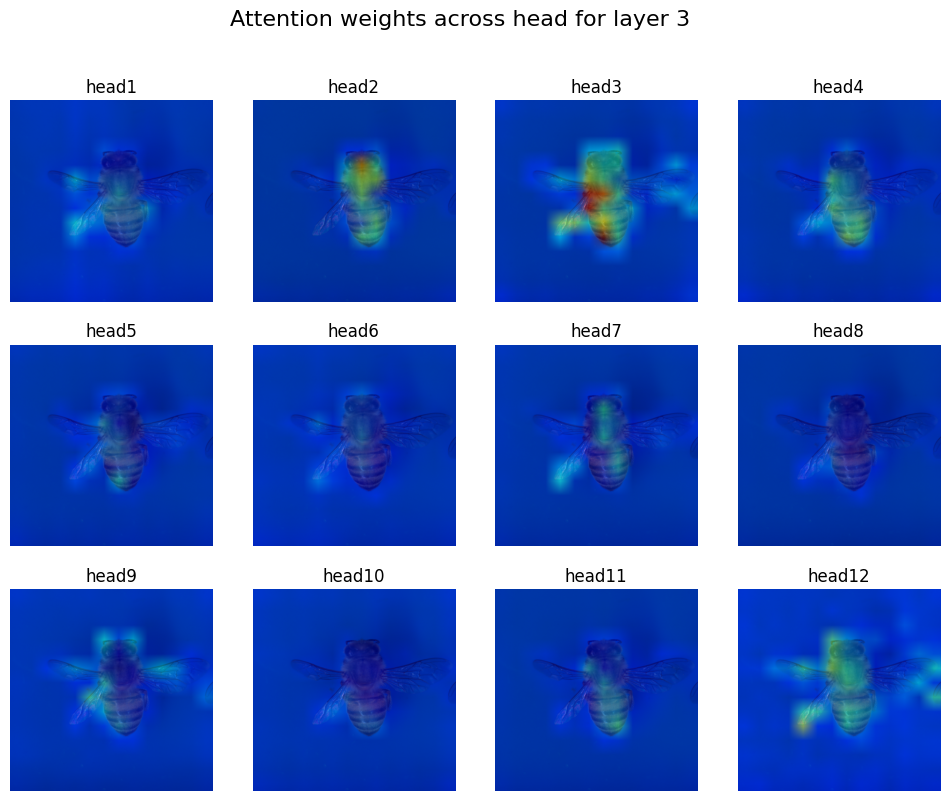

Att_all shape: (12, 197, 197)
Att_all max: 0.97890353
Att_class_token shape: (12, 196)
Prenormed min:  0.000213718 Prenormed max:  0.054399397
Normed att max and min:  1.0 0.0
Colormap shape:  (12, 196, 4)


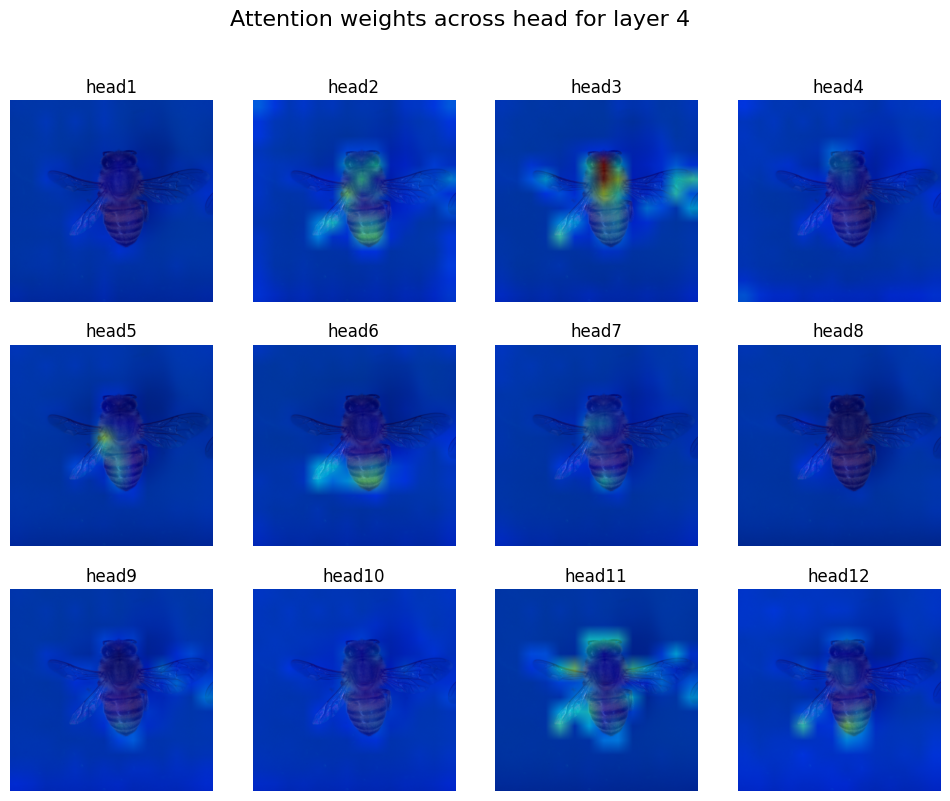

Att_all shape: (12, 197, 197)
Att_all max: 0.9182863
Att_class_token shape: (12, 196)
Prenormed min:  0.00015019445 Prenormed max:  0.05873451
Normed att max and min:  1.0 0.0
Colormap shape:  (12, 196, 4)


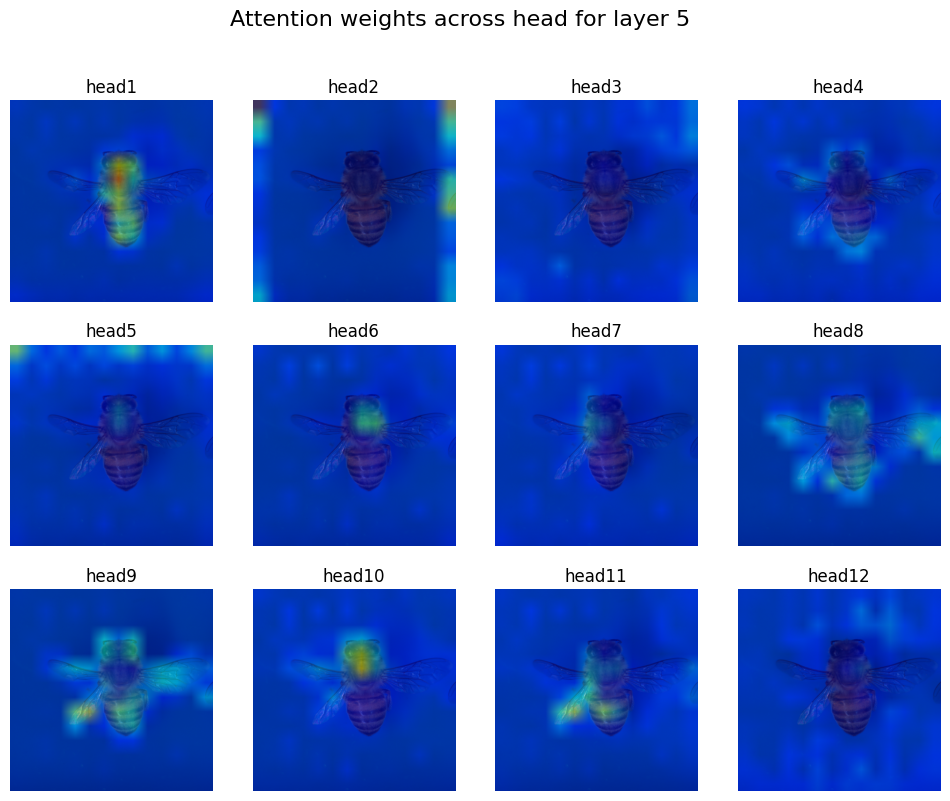

Att_all shape: (12, 197, 197)
Att_all max: 0.9798655
Att_class_token shape: (12, 196)
Prenormed min:  3.7844653e-05 Prenormed max:  0.05889582
Normed att max and min:  1.0 0.0
Colormap shape:  (12, 196, 4)


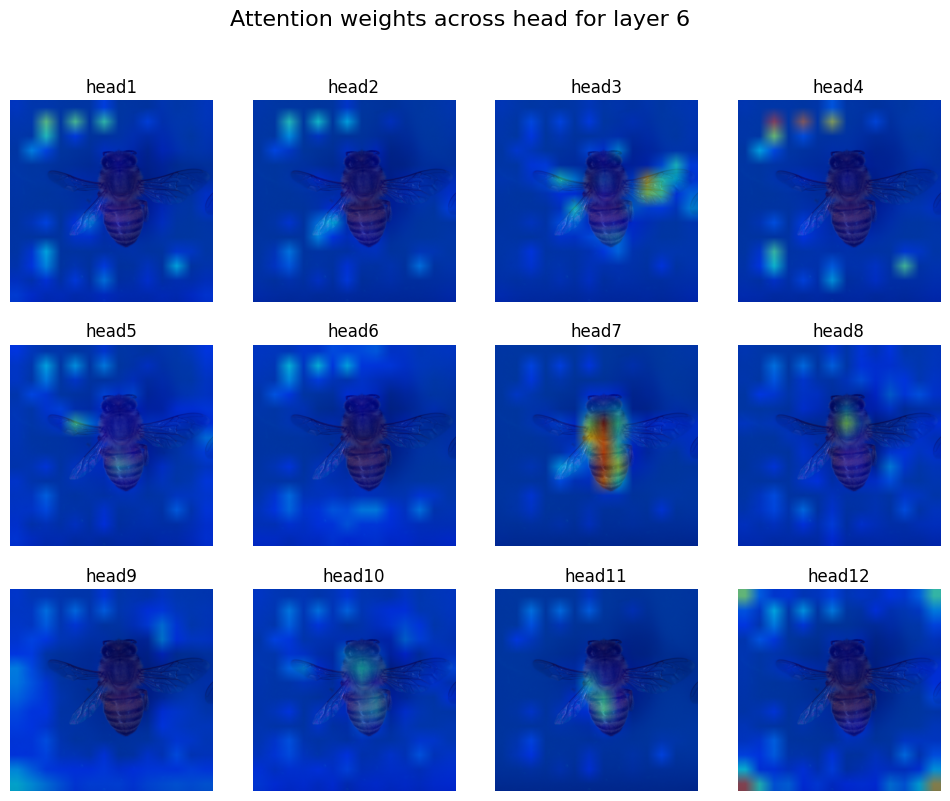

Att_all shape: (12, 197, 197)
Att_all max: 0.89892733
Att_class_token shape: (12, 196)
Prenormed min:  7.247245e-05 Prenormed max:  0.09339406
Normed att max and min:  1.0 0.0
Colormap shape:  (12, 196, 4)


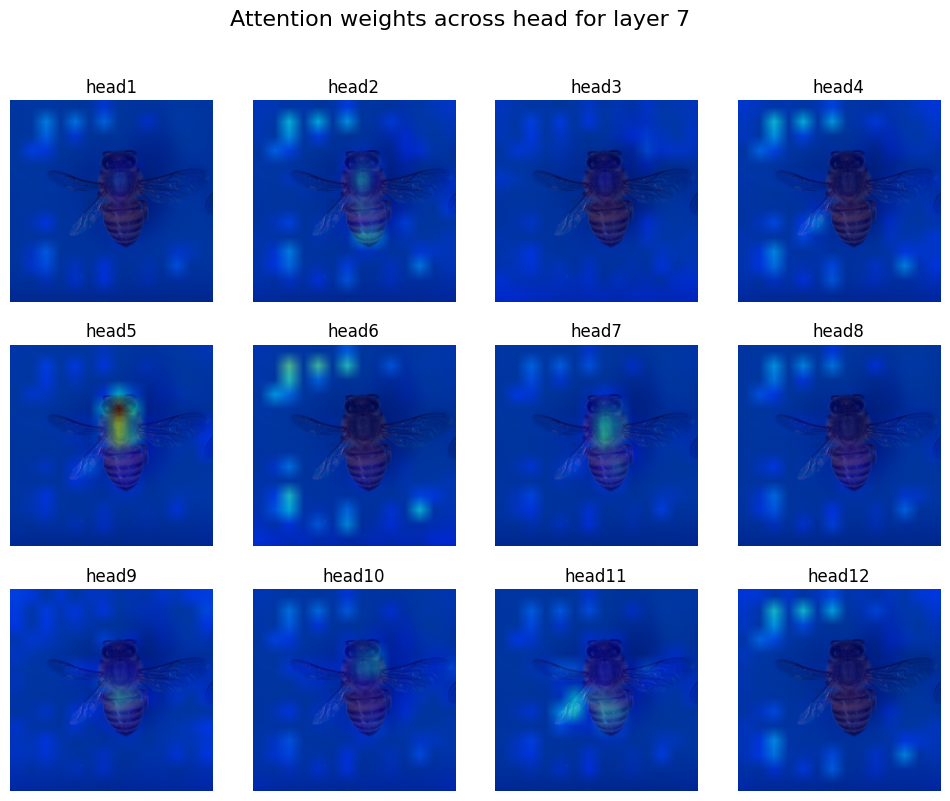

Att_all shape: (12, 197, 197)
Att_all max: 0.8670943
Att_class_token shape: (12, 196)
Prenormed min:  3.2088392e-05 Prenormed max:  0.05495282
Normed att max and min:  1.0 0.0
Colormap shape:  (12, 196, 4)


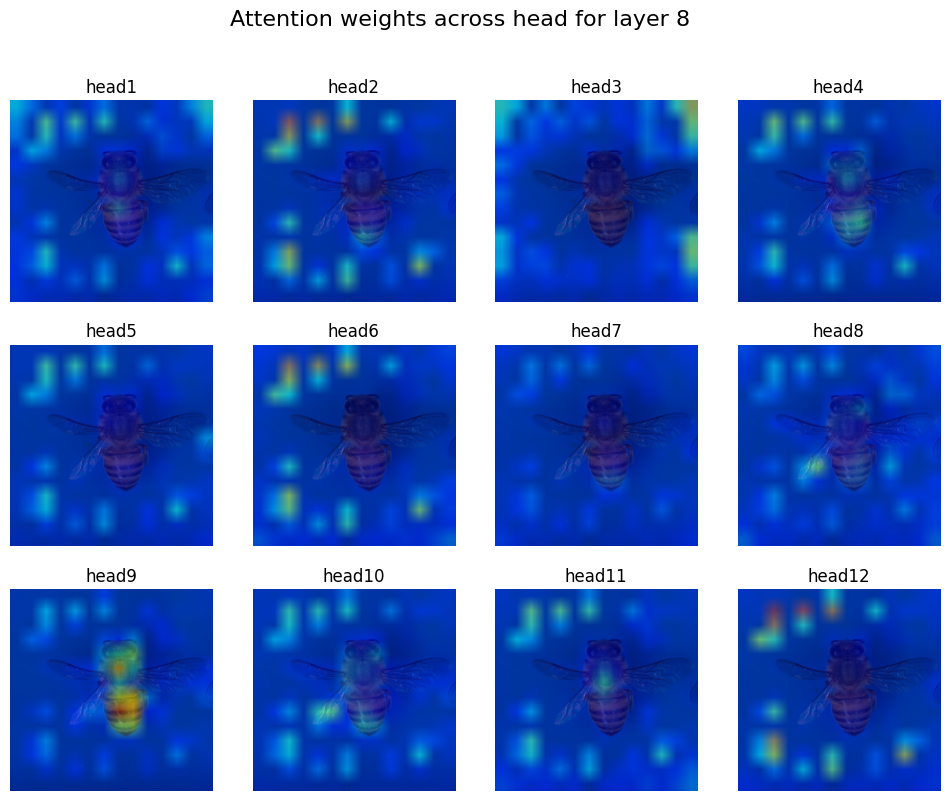

Att_all shape: (12, 197, 197)
Att_all max: 0.41665697
Att_class_token shape: (12, 196)
Prenormed min:  2.487761e-05 Prenormed max:  0.06302398
Normed att max and min:  1.0 0.0
Colormap shape:  (12, 196, 4)


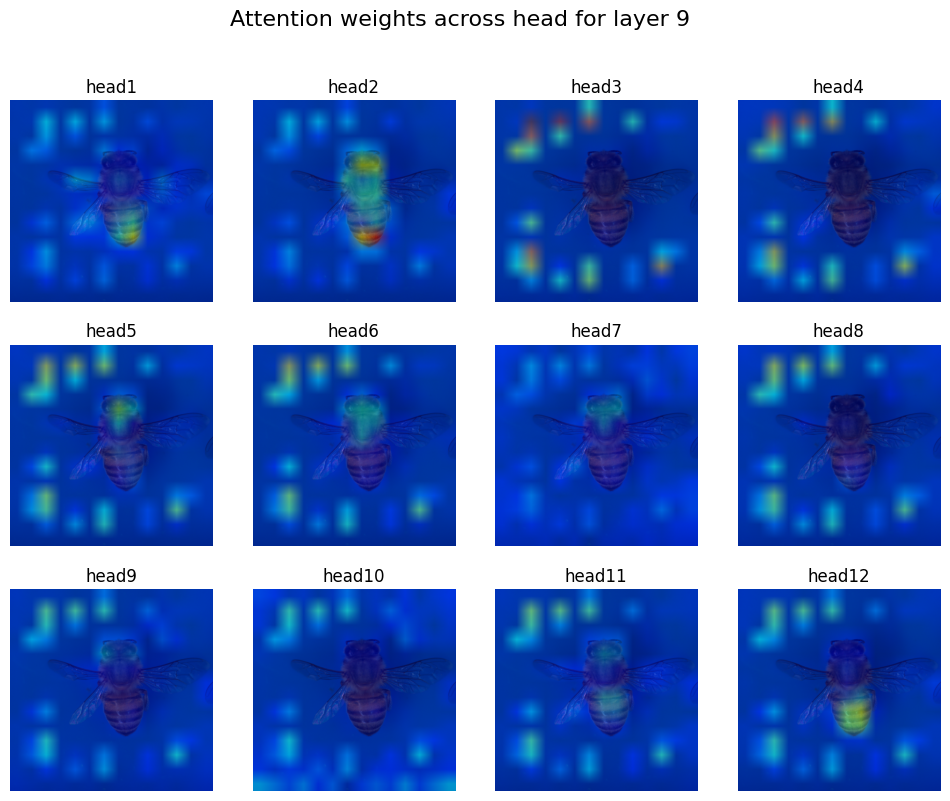

Att_all shape: (12, 197, 197)
Att_all max: 0.8721878
Att_class_token shape: (12, 196)
Prenormed min:  4.913178e-06 Prenormed max:  0.06488552
Normed att max and min:  1.0 0.0
Colormap shape:  (12, 196, 4)


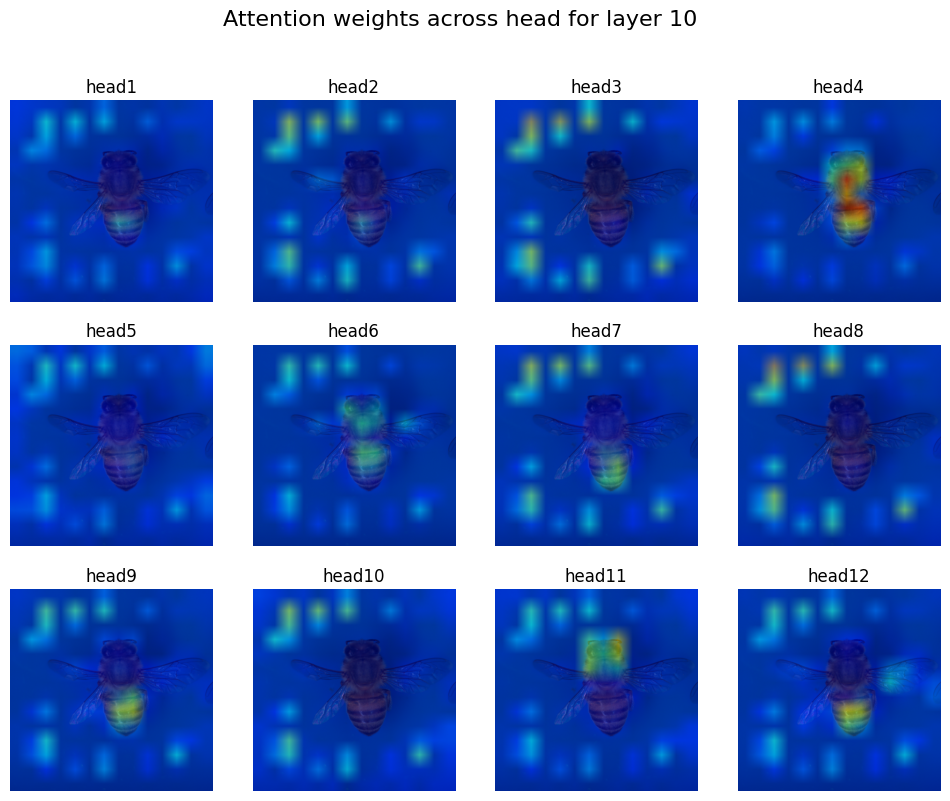

Att_all shape: (12, 197, 197)
Att_all max: 0.7483963
Att_class_token shape: (12, 196)
Prenormed min:  1.3561794e-06 Prenormed max:  0.068556756
Normed att max and min:  1.0 0.0
Colormap shape:  (12, 196, 4)


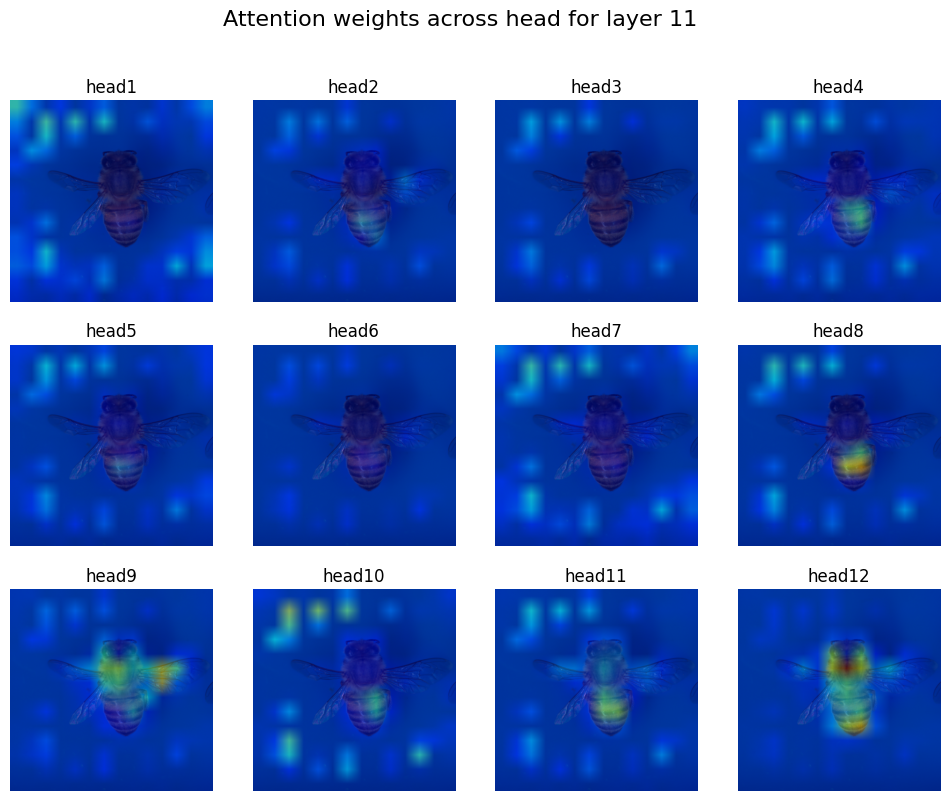

In [81]:

def display_att(att_mats, image,title_num=" ",subplot_type="head"):
    test_image_np = image
    # Set up a figure with appropriate grid size (3x4 for 12 subplots)
    fig, axes = plt.subplots(3, 4, figsize=(12, 9))
    fig.suptitle(f'Attention weights across {subplot_type} for layer {title_num}', fontsize=16)
    
    # Select only attention from class token to others 
    att_mats_np = att_mats.detach().cpu().numpy()
    print('Att_all shape:',att_mats_np.shape)
    print('Att_all max:',att_mats_np.max())
    
    att_mats_class_token = att_mats_np[:, 0, 1:]
    print('Att_class_token shape:',att_mats_class_token.shape)
         
    att_mats_flat = att_mats_class_token.flatten()
    min = att_mats_flat.min()
    max = att_mats_flat.max()
    print("Prenormed min: ",min,"Prenormed max: ",max)
    
    #Perform min-max scaling
    normed_att_mats = (att_mats_class_token - min) / (max - min + 1e-9)
    print("Normed att max and min: ",normed_att_mats.flatten().max(),normed_att_mats.flatten().min())
     
    # # Display Histogram of weight values
    # plt.figure()
    # plt.hist(normed_att_mats.flatten(), bins = 50, color='blue', alpha=0.75)
    # plt.xlabel('Weight values')
    # plt.ylabel('Frequency')
    # plt.xlim(0,1)
    # plt.yscale('log')
    # plt.title('Histogram of Weight Layer Values')


    # Apply Colormap 
    cmap = cm.get_cmap('jet')
    cmap_att = cmap(normed_att_mats)

    print("Colormap shape: ",cmap_att.shape)

    # Iterate over layers and their corresponding subplot axes
    for i, layer in enumerate(cmap_att):
        #display_histogram(layer[:,:,2])
        att_mat = layer
    
        ax = axes[i // 4, i % 4]  # Get the correct subplot (3 rows, 4 columns)
    
        # Determine grid size based on att_mat size
        grid_size = int(np.sqrt(att_mat.shape[0]))
            
        # Select only relevant elements to reshape, if att_mat has extra dimensions
        mask = att_mat.reshape(grid_size, grid_size,4)
     
        # Resize mask to match the input image dimensions
        mask = cv2.resize(mask, (test_image_np.shape[1], test_image_np.shape[0]))
        
        # Convert the normalized data to RGBA (0-255)
        rgba_array = (mask * 255).astype(np.uint8)
 
        rgba_array = np.moveaxis(rgba_array,2,-1).squeeze()
       
        rgb_array = rgba_array[..., :3]

        assert rgb_array.shape == test_image_np.shape
        assert rgb_array.dtype == test_image_np.dtype

        # Now blend the images
        result = cv2.addWeighted(rgb_array, .5, test_image_np, 0.5,0)
        ax.imshow(result)

        ax.set_title(f'{subplot_type}{i+1}')  # Add layer label
        ax.axis('off')  # Hide axes
    plt.show()

# att_mat_hf = torch.moveaxis(att_mat,0,1)
# print(att_mat_hf.size())
print("Layer wise shape: ",att_mat[-1].flatten(1,-1).size())
print("Layer wise max: ",att_mat[-1].flatten(1,-1).max(axis=0))



for i, layer in enumerate(att_mat):
    display_att(layer,test_image_np,i,"head")

TypeError: Invalid shape (12, 197, 197) for image data

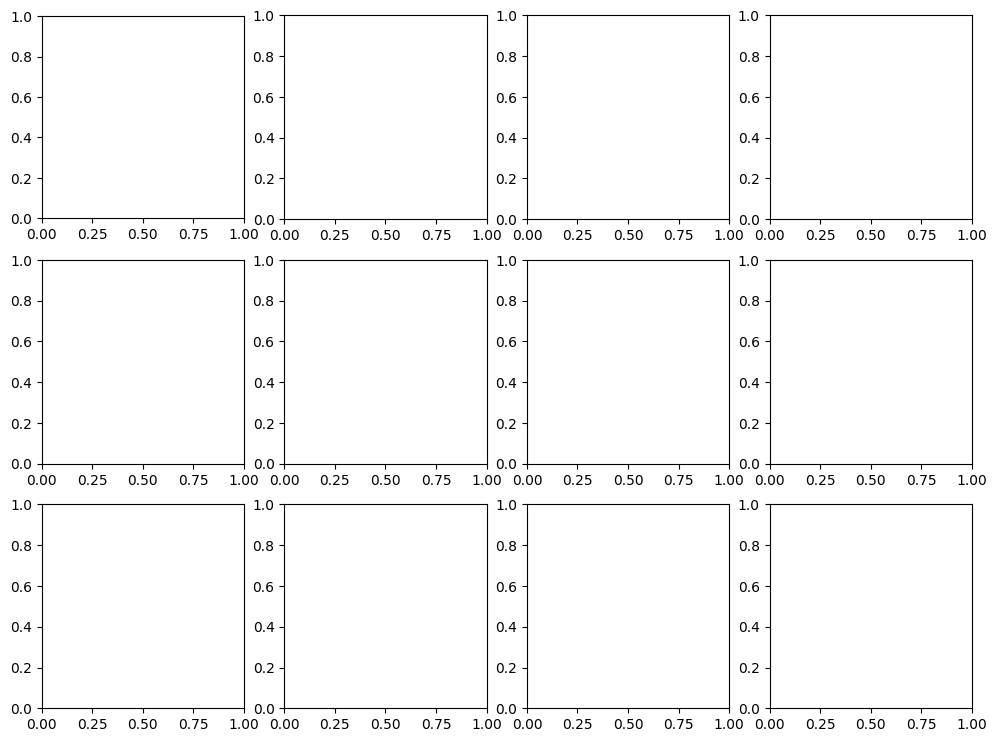

In [64]:

num_layers = len(att_mat)

# Set up a figure with appropriate grid size (3x4 for 12 subplots)
fig, axes = plt.subplots(3, 4, figsize=(12, 9))


# Iterate over layers and their corresponding subplot axes
for i, layer in enumerate(att_mat):
    ax = axes[i // 4, i % 4]  # Get the correct subplot (3 rows, 4 columns)
    ax.imshow(layer.detach().cpu().numpy(), cmap='jet')  # Display layer
    ax.set_title(f'Layer {i+1}')  # Add layer label
    ax.axis('off')  # Hide axes

# Adjust layout to prevent overlapping
plt.tight_layout()

# Show the figure with all subplots
plt.show()

plt.style.use('dark_background')
att_mat_flat = att_mat.sum(axis=0)
print(att_mat_flat.size())
plt.title("Summed attention by layer")
plt.imshow(att_mat_flat.detach().cpu().numpy(), cmap='jet')
plt.axis("off")


In [ ]:
#VIT CODE 
output = model(x)
logits = output["pooler_output"]
att_mat = output["attentions"]
att_mat = torch.stack(att_mat).squeeze(1)
print(att_mat.size())
att_mat = torch.mean(att_mat, dim=1) #dont need mean for bioclip

In [42]:

im = test_image
# Average the attention weights across all heads.

print(att_mat)

# To account for residual connections, we add an identity matrix to the
# attention matrix and re-normalize the weights.
residual_att = torch.eye(att_mat.size(1)).to(device)

aug_att_mat = att_mat + residual_att
aug_att_mat = aug_att_mat / aug_att_mat.sum(dim=-1).unsqueeze(-1)
print(aug_att_mat.size())

# Recursively multiply the weight matrices
joint_attentions = torch.zeros(aug_att_mat.size()).to(device)
joint_attentions[0] = aug_att_mat[0]
print(aug_att_mat.size(),aug_att_mat[0].size())
print(joint_attentions.size())

for n in range(1, aug_att_mat.size(0)):
    joint_attentions[n] = torch.matmul(aug_att_mat[n], joint_attentions[n-1])
    print(f"multiplying aug_att_mat[{n}] by joint[{n-1}] to set joint[{n}]")
# Attention from the output token to the input space.
v = joint_attentions[-1]
grid_size = int(np.sqrt(aug_att_mat.size(-1)))
mask = v[0, 1:].reshape(grid_size, grid_size).cpu().detach().numpy()
mask = cv2.resize(mask / mask.max(), (test_image_np.shape[1], test_image_np.shape[0]))[..., np.newaxis]


tensor([[[3.5949e-01, 2.2701e-03, 2.2715e-03,  ..., 1.9984e-03,
          1.7783e-03, 1.7262e-03],
         [1.6619e-01, 1.1067e-02, 1.1995e-02,  ..., 9.3821e-03,
          1.1558e-02, 2.2137e-02],
         [1.6686e-01, 1.0560e-02, 1.2304e-02,  ..., 8.9413e-03,
          1.1207e-02, 2.2601e-02],
         ...,
         [2.5720e-01, 2.0051e-03, 1.8057e-03,  ..., 1.3798e-01,
          8.8052e-02, 7.9444e-02],
         [2.4734e-01, 2.0198e-03, 1.7589e-03,  ..., 1.1107e-01,
          1.1883e-01, 9.0334e-02],
         [2.3022e-01, 2.0197e-03, 1.8765e-03,  ..., 1.1941e-01,
          1.0223e-01, 9.5024e-02]],

        [[5.9696e-01, 9.3681e-04, 8.6334e-04,  ..., 7.4843e-03,
          9.1188e-03, 1.2817e-02],
         [1.4319e-01, 1.4203e-02, 2.1364e-02,  ..., 5.0391e-04,
          8.6112e-04, 1.0404e-03],
         [1.5102e-01, 1.4812e-02, 1.6241e-02,  ..., 4.1728e-04,
          7.6497e-04, 9.9394e-04],
         ...,
         [3.6487e-01, 6.2902e-04, 6.0261e-04,  ..., 6.1111e-02,
          7.062

In [43]:
import matplotlib.cm as cm
cmap = cm.get_cmap('jet')
# Convert the normalized data to RGBA (0-255)
rgba_array = (cmap(mask) * 255).astype(np.uint8)
rgba_array = np.moveaxis(rgba_array,2,-1).squeeze()
rgb_array = rgba_array[..., :3]

/tmp/ipykernel_1328793/2400100950.py:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cm.get_cmap('jet')


In [44]:


print(rgb_array.shape)
print(rgb_array.dtype)
print(test_image_np.shape)
print(test_image_np.dtype)
# Now blend the images
result = cv2.addWeighted(rgb_array, 0.7, test_image_np, 0.5, 0)

(4000, 6000, 3)
uint8
(4000, 6000, 3)
uint8


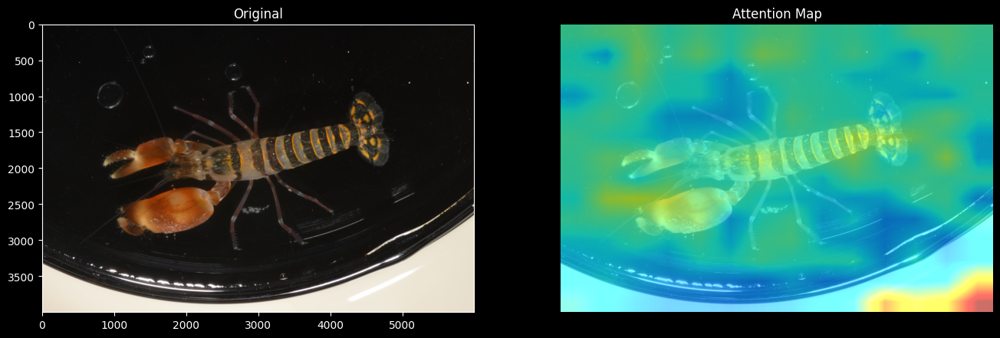

In [45]:
fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(16, 16))

ax1.set_title('Original')
ax2.set_title('Attention Map')
_ = ax1.imshow(im)
_ = ax2.imshow(result)
plt.axis("off")
probs = torch.nn.Softmax(dim=-1)(logits)
top5 = torch.argsort(probs, dim=-1, descending=True)

# for idx in top5[0, :5]:
#     print(f'{probs[0, idx.item()]:.5f} : {imagenet_labels[idx.item()]}', end='')

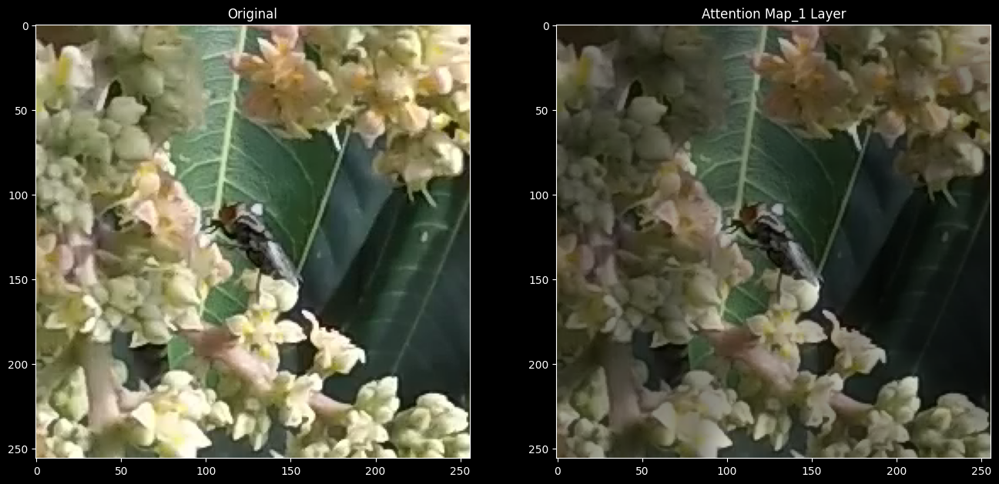

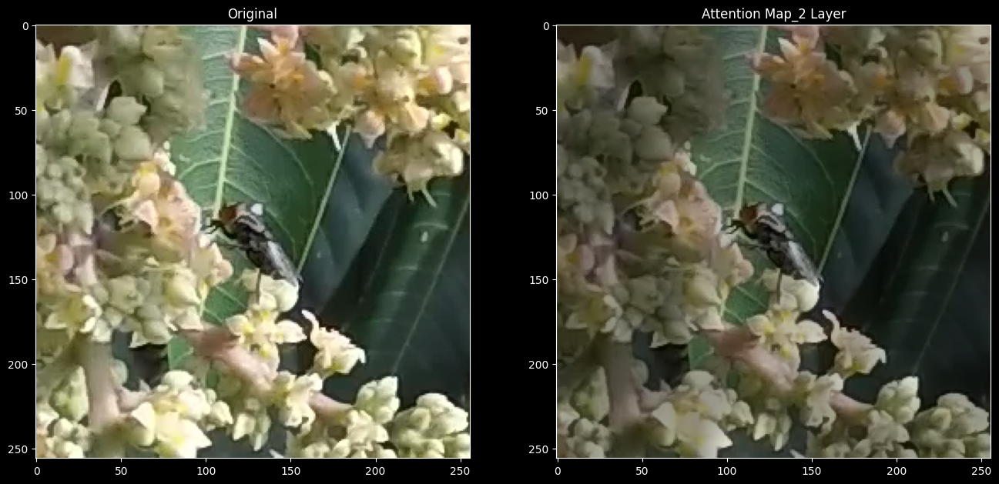

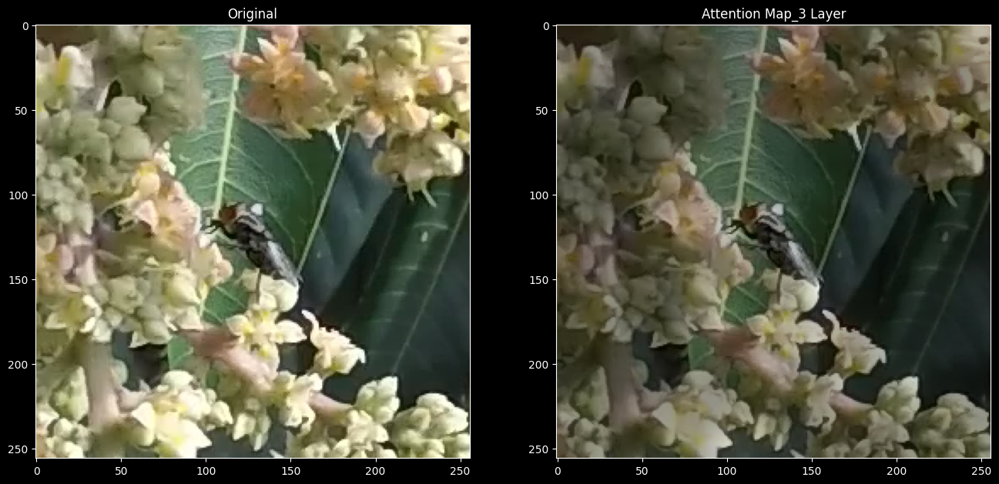

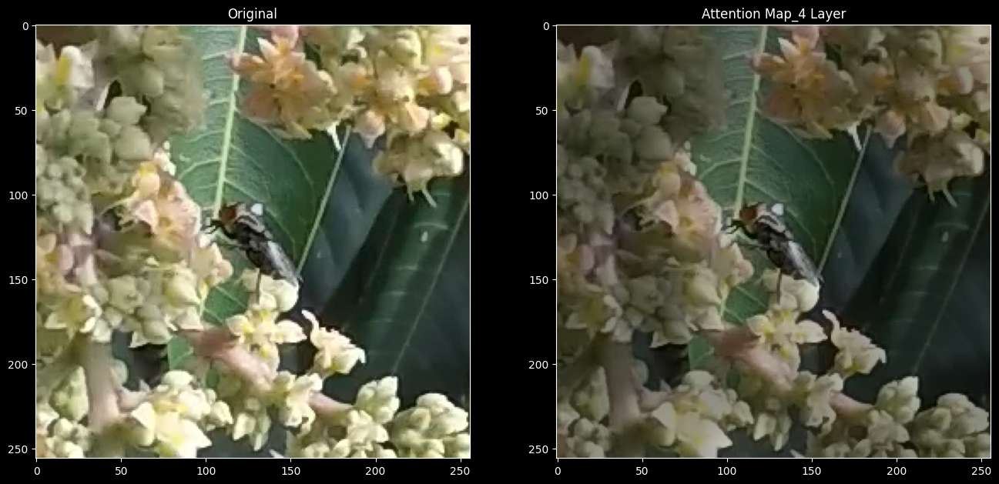

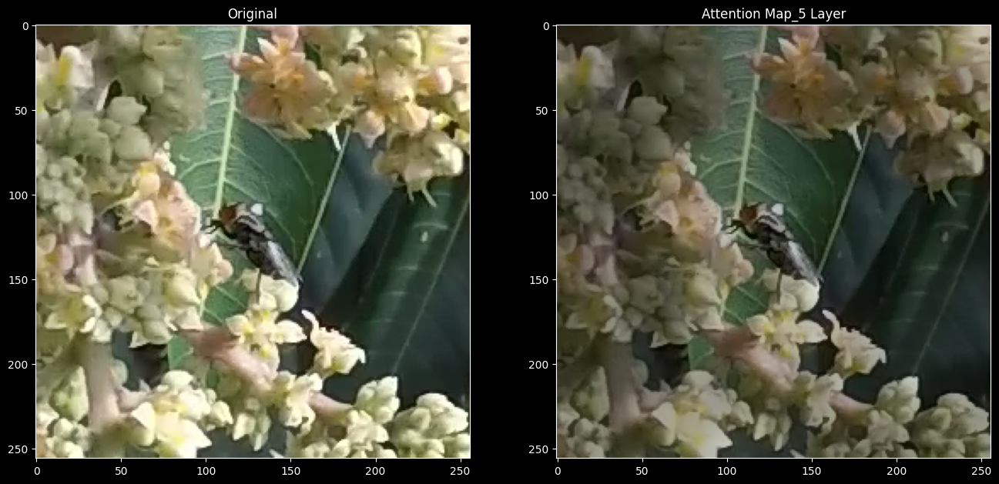

...

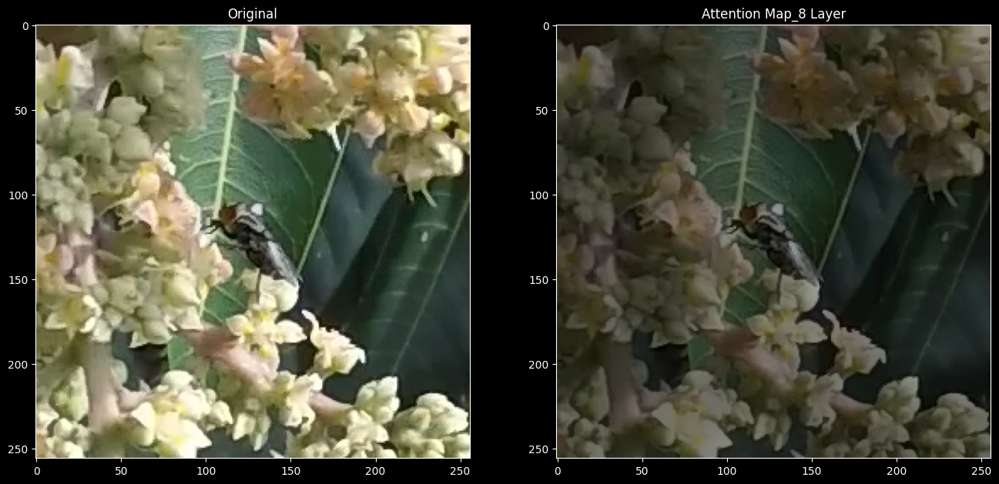

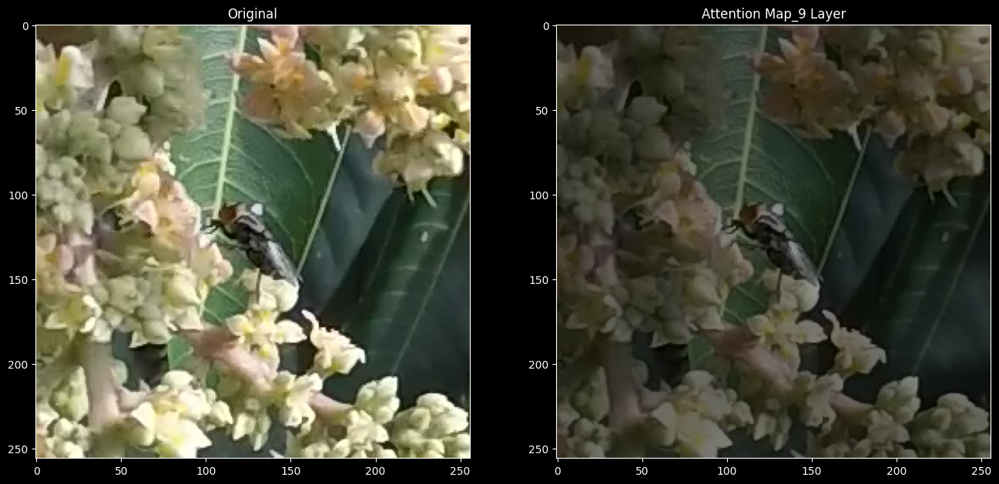

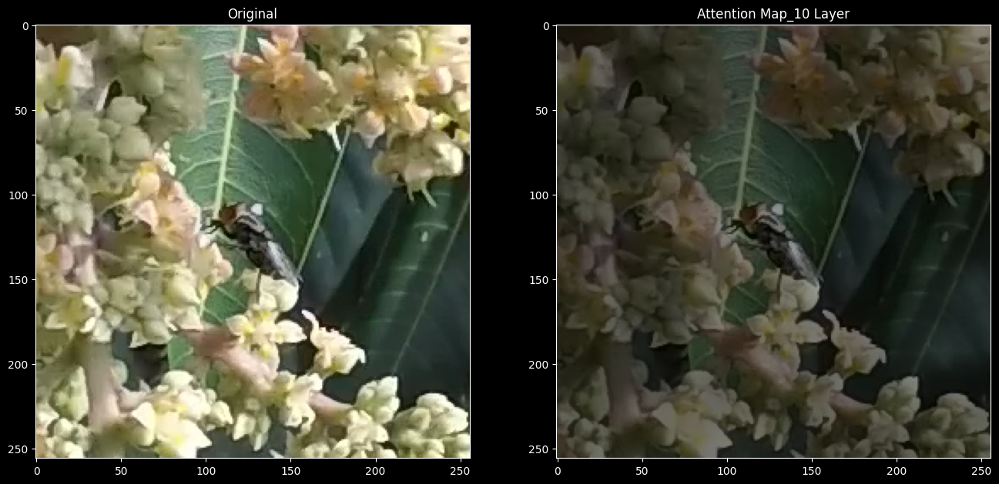

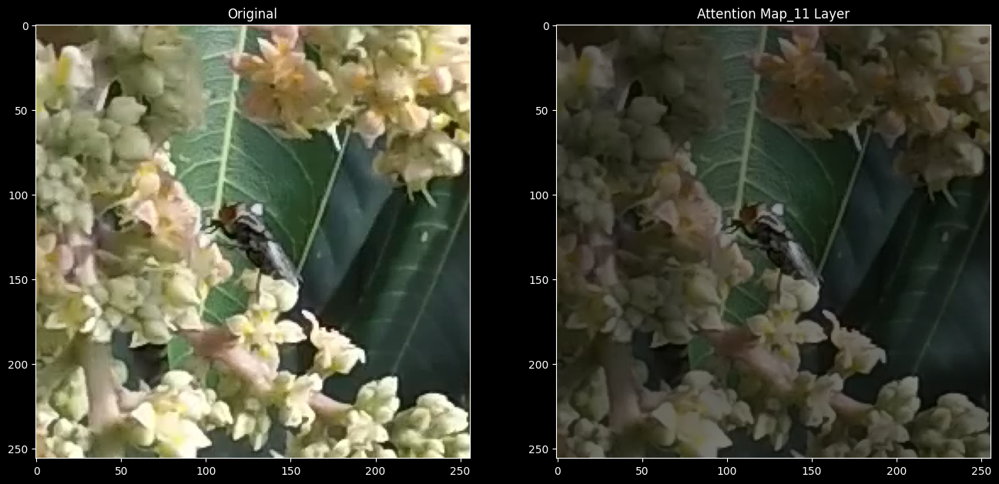

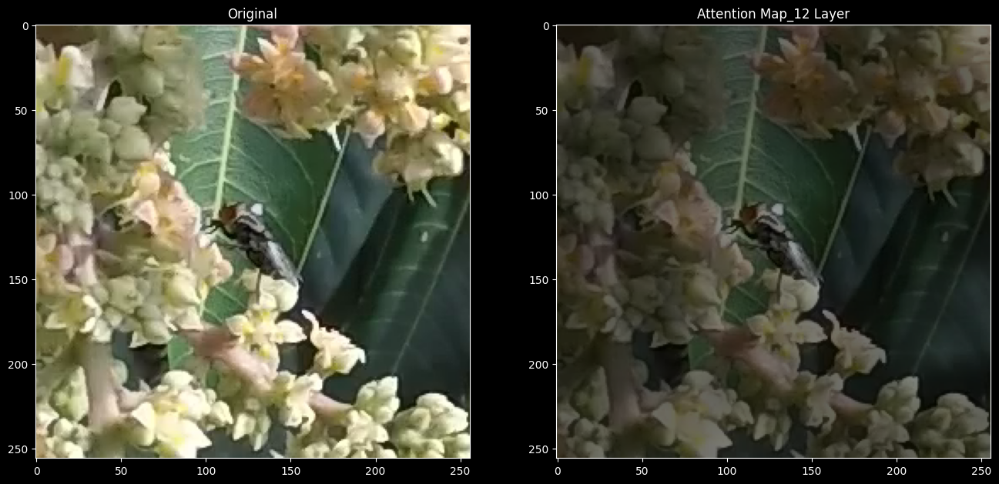

In [45]:
for i, v in enumerate(joint_attentions):
    # Attention from the output token to the input space.
    mask = v[0, 1:].reshape(grid_size, grid_size).cpu().detach().numpy()
    mask = cv2.resize(mask / mask.max(), im.size)[..., np.newaxis]
    result = (mask * im).astype("uint8")

    fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(16, 16))
    ax1.set_title('Original')
    ax2.set_title('Attention Map_%d Layer' % (i+1))
    _ = ax1.imshow(im)
    _ = ax2.imshow(result)